# **Introduction**

A migrant worker is a person who either migrates within their home country or outside it to pursue work. Migrant workers usually do not have the intention to stay permanently in the country or region in which they work. Despite the beneficial effects of international labour migration, migrant workers face many challenges including modern slavery, discrimination, contract violations, abuse and exploitation, and unsafe working conditions, which are often dirty, demeaning, and dangerous.**The main objective of this project is to analyze the Gender, Age, State, Experience, ID proof and Skills of the migrant workers.**


**Step 1: Import needed modules**

In [0]:
import pandas as pd
import matplotlib.pyplot as plt

**Step 2: Upload data.**   
Please download the the csv file from :      
https://samvarta.org/testdata.csv   
Please download this file for city replacement data :  
https://github.com/Anirudh1905/Migrant_Worker_Analysis/raw/master/cityreplacements.xlsx  
Please downnload this file for clean Skill Data :  
https://github.com/Anirudh1905/Migrant_Worker_Analysis/raw/master/skilldata.xlsx  
Please download this file for converting city to state :  
https://github.com/Anirudh1905/Migrant_Worker_Analysis/raw/master/city_to_state.xlsx  
Please download this for adding states :  
https://github.com/Anirudh1905/Migrant_Worker_Analysis/raw/master/addstate.xlsx  
Please download this json file for viewing India map and states :  
https://drive.google.com/file/d/1eRI3cedcyEpnSY5irXPFImR-ImBodAEz/view?usp=sharing  
**Please download and Upload all the data as it will be helpful for Analyzing**


In [0]:
from google.colab import files
files.upload()

Saving addstate.xlsx to addstate.xlsx
Saving city_to_state.xlsx to city_to_state.xlsx
Saving cityreplacements.xlsx to cityreplacements.xlsx
Saving india_states.geojson to india_states.geojson
Saving skilldata.xlsx to skilldata.xlsx
Saving testdata.csv to testdata.csv


{'addstate.xlsx': b'PK\x03\x04\x14\x00\x06\x00\x08\x00\x00\x00!\x00b\xee\x9dh^\x01\x00\x00\x90\x04\x00\x00\x13\x00\x08\x02[Content_Types].xml \xa2\x04\x02(\xa0\x00\x02\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\

**Step 3: Read csv file into pandas and look at some values**

In [0]:
# Define column names by hand for easier clean up.
columnnames=['SerialNumber', 'Tehsil', 'Block',
                        'Village', 'FullName', 'FathersFullName',
                        'Age', 'Sex', 'PhoneNumber',
                        'IDProof', 'IDNumber', 'ArrivalDate',
                        'SourceCity', 'SourceCheckup', 'Skill', 'YrsExp',
                        'OtherSkills', 'CompanyName', 'Comments']

df=pd.read_csv('/content/testdata.csv')
df.columns=columnnames
df.head()

,SerialNumber,Tehsil,Block,Village,FullName,FathersFullName,Age,Sex,PhoneNumber,IDProof,IDNumber,ArrivalDate,SourceCity,SourceCheckup,Skill,YrsExp,OtherSkills,CompanyName,Comments
0,1,BASTI SADAR,BAHADUR PUR,Deidentified,Deidentified,Deidentified,15.0,MALE,12345678,ADHAR,9999999999,09-05-2020,MUMBAI,YES,LABOUR,7 MONTH,NaN,NaN,NaN
1,2,BASTI SADAR,BAHADUR PUR,Deidentified,Deidentified,Deidentified,22.0,MALE,12345678,ADHAR,9999999999,09-05-2020,MUMBAI,YES,LABOUR,5 MONTHS,NaN,NaN,NaN
2,3,BASTI SADAR,Bahadur pur,Deidentified,Deidentified,Deidentified,20.0,F,12345678,NaN,9999999999,29-04-2020,Prayagraj,YES,NaN,NaN,NaN,NaN,NaN
3,4,BASTI SADAR,Bahadur pur,Deidentified,Deidentified,Deidentified,21.0,M,12345678,NaN,9999999999,29-04-2020,Prayagraj,YES,NaN,NaN,NaN,NaN,NaN
4,5,BASTI SADAR,Bahadur pur,Deidentified,Deidentified,Deidentified,21.0,M,12345678,NaN,9999999999,29-04-2020,Prayagraj,YES,NaN,NaN,NaN,NaN,NaN


# **Analyzing Gender of Workers**

**Step 4: Lets try to analyze gender (and clean it)**   
List all the unique values in the Sex column.   
You will see many different variations.    
These will be cleaned in Step 6


In [0]:
### Print all unique values in the sex column
print("Current Unique values in Sex (and counts):")
df.groupby(['Sex'])['SerialNumber'].count()

Current Unique values in Sex (and counts):


Sex
F          40
FEMALE      2
M         526
MALE       56
ड           2
पु0        80
म           1
म0          2
Name: SerialNumber, dtype: int64

**Step 5: Fix the bad data**   
We only want this column to contain M or F.   
We will manually change values which contain bad values such as MALE, FEMALE, ड, म0, म and so on.

In [0]:
#cleaning the data
a=["MALE","FEMALE","पु0","म0","म","nan","ड"]
b=['M','F','M','F','F','U','U']
df.replace(a,b,inplace=True)
print("Updated unique values in Sex:")
df1=df.replace(['M','F','U'],['Male','Female','Unknown'])
#creating dataframe for the sex of the workers
df1=df1.groupby(['Sex'])['SerialNumber'].count()
df1

Updated unique values in Sex:


Sex
Female      45
Male       662
Unknown      2
Name: SerialNumber, dtype: int64

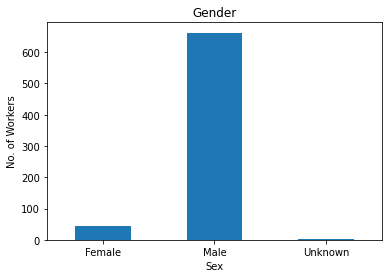

In [0]:
#visualizing the above dataframe
df1.plot(kind='bar')
plt.title('Gender')
plt.xticks(rotation='0')
plt.ylabel('No. of Workers')
plt.show()

**Most of the workers are Male whereas very few of them are Female.**

**Step 6: Lets look at data and see what else can we fix**

In [0]:
df.head()

,SerialNumber,Tehsil,Block,Village,FullName,FathersFullName,Age,Sex,PhoneNumber,IDProof,IDNumber,ArrivalDate,SourceCity,SourceCheckup,Skill,YrsExp,OtherSkills,CompanyName,Comments
0,1,BASTI SADAR,BAHADUR PUR,Deidentified,Deidentified,Deidentified,15.0,M,12345678,ADHAR,9999999999,09-05-2020,MUMBAI,YES,LABOUR,7 MONTH,NaN,NaN,NaN
1,2,BASTI SADAR,BAHADUR PUR,Deidentified,Deidentified,Deidentified,22.0,M,12345678,ADHAR,9999999999,09-05-2020,MUMBAI,YES,LABOUR,5 MONTHS,NaN,NaN,NaN
2,3,BASTI SADAR,Bahadur pur,Deidentified,Deidentified,Deidentified,20.0,F,12345678,NaN,9999999999,29-04-2020,Prayagraj,YES,NaN,NaN,NaN,NaN,NaN
3,4,BASTI SADAR,Bahadur pur,Deidentified,Deidentified,Deidentified,21.0,M,12345678,NaN,9999999999,29-04-2020,Prayagraj,YES,NaN,NaN,NaN,NaN,NaN
4,5,BASTI SADAR,Bahadur pur,Deidentified,Deidentified,Deidentified,21.0,M,12345678,NaN,9999999999,29-04-2020,Prayagraj,YES,NaN,NaN,NaN,NaN,NaN


**Step 7: Change all Block names to Bahadurpur**   
Looks like they can contain different spellings or variations. Just fix all to the same value.

In [0]:
print("Block names before cleaning")
df.groupby('Block')['SerialNumber'].count()

Block names before cleaning


Block
BAHADUR PUR     61
BAHADURPUR     447
BAHDURPR         3
BAHDURPUR        2
BHADHUR         11
BHADHUR PUR     69
BHADHURPUR       9
BHADURPUR        7
Bahadur Pur      3
Bahadur pur      5
Bahdhur          2
Bhadhur          1
Bhadhur pur      6
Bhadhurpur       4
बहादुरपुर       80
Name: SerialNumber, dtype: int64

In [0]:
### Fill code here to replace all "Block" values with "BAHADURPUR"
print("Block names after cleaning:")
c=['BAHADUR PUR','BAHADURPUR','BAHDURPR','BAHDURPUR','BHADHUR','BHADHUR PUR','BHADHURPUR','BHADURPUR','Bahadur Pur','Bahadur pur','Bahdhur','Bhadhur','Bhadhur pur','Bhadhurpur','बहादुरपुर']

### Fill code to show values and counts
df.replace(c,'BAHADURPUR',inplace=True)
df.groupby(['Block'])['SerialNumber'].count()

Block names after cleaning:


Block
BAHADURPUR    710
Name: SerialNumber, dtype: int64

# **Analyzing the Source City of the Workers**

**Let's look at possible city names**   
Note: We want to print ALL names, not just some of them.

In [0]:
### print all city names
for x in df['SourceCity'].unique():
  print(x)

MUMBAI
Prayagraj
DELHI
INDORE
FARIDABAD
HYDRABAD
GUJRAT
MADHYA PRADESH
ANDHRA PRADESH
GURGAON
AHAMADABAD
KANPUR
ALIGARH
GONDA
nan
AMRITSAR
RAJASTHAN
BOMBAY
BALLABHGARH
NOIDA
AHEMADABAD
NAGPUR
MATHURA
AHAMDABAD
BHIMANDI
THANE
PUNE
SURAT
HAPUR
SAHARANPUR
HARYANA
BHIWNDI
AHMEDABAD
TELANGANA
HARIYANA
BHIWANDI
JALGAUV
RAJSTHAN
MAHARASTRA
KERALA
BRODARA
BANGOLORE
KERLA
MHARSATRA
LUCKNOW
GUDGAWA
NAGH PUR
MHARASTRA
AMDABAD
BANGLOR
JHASI
PUNA
SAHARAN PUR
HARAYAN
CHNADI GHAR
GAZIYABAD
NASIK
VASAI MUMBAI
BEGLORE
ULWAY MUMBAI
मुम्बई
मुम्बई भिवडी
सूरत
हैदराबाद
तेलंगाना
लुधियाना
हापुड
मुम्बई मानखुर्द एकतानगर
गुजरात गोधरा
थाने
वसई
बसई
अन्धेरी बेस्ट
पुणे
गुजरात
केरल
MUMBAI CST
AHAMADNAGAR
BELAUR
NIGOJ
MMBAI
MAHARSHTRA
fnYyh
Fkkus
eqEcbZ
POONA
MUMABAI
HENFRABAD
HAIDRABAD
BANGLORE
RAJESTHA
SOLAPUR
AGRA
JAMMU
GUJRAAT
BEGOLOR
AGARA
AHMADABAD
कानपुर
अहमदाबाद


**Step 8: Fix city names**   
The city names are dirty, for example:   
HAIDRABAD, Hyderabad, Hyderabad   
BANGLORE, BANGALORE, Bangalore, Begolore   
GUJRAT, GUJARAT, GUJRAAT   
AGARA, AGRA   
कानपुर, Kanpur    
Mumbai, MUMABAI, मुम्बई, मुम्बई भिवडी, VASAI MUMBAI
  

In [0]:
df2=pd.read_excel('/content/cityreplacements.xlsx')
dg=df.copy()
z=df2['Current Value'].tolist()
y=df2['New Value'].tolist()
df.replace(z,y,inplace=True)
df.head()

,SerialNumber,Tehsil,Block,Village,FullName,FathersFullName,Age,Sex,PhoneNumber,IDProof,IDNumber,ArrivalDate,SourceCity,SourceCheckup,Skill,YrsExp,OtherSkills,CompanyName,Comments
0,1,BASTI SADAR,BAHADURPUR,Deidentified,Deidentified,Deidentified,15,M,12345678,ADHAR,9999999999,09-05-2020,Mumbai,YES,LABOUR,7 MONTH,unknown,unknown,unknown
1,2,BASTI SADAR,BAHADURPUR,Deidentified,Deidentified,Deidentified,22,M,12345678,ADHAR,9999999999,09-05-2020,Mumbai,YES,LABOUR,5 MONTHS,unknown,unknown,unknown
2,3,BASTI SADAR,BAHADURPUR,Deidentified,Deidentified,Deidentified,20,F,12345678,unknown,9999999999,29-04-2020,Prayagraj,YES,unknown,unknown,unknown,unknown,unknown
3,4,BASTI SADAR,BAHADURPUR,Deidentified,Deidentified,Deidentified,21,M,12345678,unknown,9999999999,29-04-2020,Prayagraj,YES,unknown,unknown,unknown,unknown,unknown
4,5,BASTI SADAR,BAHADURPUR,Deidentified,Deidentified,Deidentified,21,M,12345678,unknown,9999999999,29-04-2020,Prayagraj,YES,unknown,unknown,unknown,unknown,unknown


In [0]:
#creating dataframe for the source city of the workers
dx=pd.read_excel('/content/city_to_state.xlsx') #converting city to their respective state
a=dx['City'].tolist()
b=dx['State'].tolist()
df.replace(a,b,inplace=True)
dsa=df.groupby('SourceCity')['SerialNumber'].count()
dsa=dsa.reset_index()
dsa.rename(columns={'SerialNumber':'Count','SourceCity':'State'},inplace=True)
dsb=pd.read_excel('/content/addstate.xlsx')
dsa=dsa.append(dsb,ignore_index=True)
dsa.sort_values(by='Count',ascending=False,ignore_index=True,inplace=True)
dsa.head()

,State,Count
0,Maharashtra,407
1,Gujarat,85
2,Uttar Pradesh,56
3,Delhi,43
4,Haryana,32


In [0]:
#visualizing the above dataframe by creating map
import folium
in_geo=r'/content/india_states.geojson'
in_map = folium.Map(location=[20.5937, 78.9629], zoom_start=5)

folium.Choropleth(
    geo_data=in_geo,
    data=dsa,
    columns=['State', 'Count'],
    key_on='feature.properties.NAME_1',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name='Number of workers',
    reset=True
).add_to(in_map)
in_map

<a href="https://ibb.co/CV8pRTk"><img src="https://i.ibb.co/5s4XbfN/indiamap.jpg" alt="indiamap" border="0"></a>

**Most of the workers come from Maharashtra and Gujarat whereas very few come from other states.**

# **Analyzing the Experience of the Workers**

**Step 9: Clean the YrsExp column**   
   
This column can contain many dirty values.    
After clean up, all this column should contain is a number that represents number of years.   
For example, any years > 10 should be replaced by 10,   
and any value in months should be replaced by 0.   


In [0]:
import re
s=[];c=0
for x in df['YrsExp'].values:
  if x.find('M')!=-1 or x.find('मा')!=-1:
    s.append(0)  #converting monthhs to 0 yrs
  else:
    if x=='unknown':
      s.append(0)
    else:
      w=re.findall("\d+", x)
      for z in w:
        if int(z)>10:  #converting years greater than 10 as 10
          s.append(10)
        else:
          s.append(int(z))         

In [0]:
df.drop(['YrsExp'],axis=1,inplace=True)
df.insert(15,'YrsExp',s)
df.head()

,SerialNumber,Tehsil,Block,Village,FullName,FathersFullName,Age,Sex,PhoneNumber,IDProof,IDNumber,ArrivalDate,SourceCity,SourceCheckup,Skill,YrsExp,OtherSkills,CompanyName,Comments
0,1,BASTI SADAR,BAHADURPUR,Deidentified,Deidentified,Deidentified,15,M,12345678,ADHAR,9999999999,09-05-2020,Maharashtra,YES,LABOUR,0,unknown,unknown,unknown
1,2,BASTI SADAR,BAHADURPUR,Deidentified,Deidentified,Deidentified,22,M,12345678,ADHAR,9999999999,09-05-2020,Maharashtra,YES,LABOUR,0,unknown,unknown,unknown
2,3,BASTI SADAR,BAHADURPUR,Deidentified,Deidentified,Deidentified,20,F,12345678,unknown,9999999999,29-04-2020,Uttar Pradesh,YES,unknown,0,unknown,unknown,unknown
3,4,BASTI SADAR,BAHADURPUR,Deidentified,Deidentified,Deidentified,21,M,12345678,unknown,9999999999,29-04-2020,Uttar Pradesh,YES,unknown,0,unknown,unknown,unknown
4,5,BASTI SADAR,BAHADURPUR,Deidentified,Deidentified,Deidentified,21,M,12345678,unknown,9999999999,29-04-2020,Uttar Pradesh,YES,unknown,0,unknown,unknown,unknown


In [0]:
#creating dataframe for the experience(in years) of the workers
dfk=df.groupby(['YrsExp'])['SerialNumber'].count()
r=dfk.index.tolist()
r[-1]='10+'
dfk.index=r
dfk

0      175
1       87
2       77
3       57
4       45
5       82
6       24
7       21
8       17
9        9
10+    116
Name: SerialNumber, dtype: int64

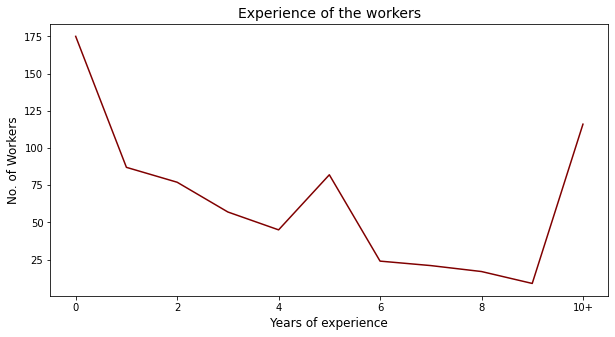

In [0]:
#visualizing the dataframe
dfk.plot(kind='line',color='maroon',figsize=(10,5))
plt.title('Experience of the workers',fontsize=14)
plt.xlabel('Years of experience',fontsize=12)
plt.ylabel('No. of Workers',fontsize=12)
plt.show()

**Most of the workers are inexperienced**

In [0]:
!pip install fuzzywuzzy

In [0]:
### Add code or code cells here to clean city list using fuzzy matching if score is more than 60%.
### Note you may need to check for मुम्बई  and Mumbai because fuzzy matching cannot work across fonts in hindi and english.
from fuzzywuzzy import process

dg.fillna('unknown',inplace=True)
p=['मुम्बई','मुम्बई भिवडी','सूरत','हैदराबाद','तेलंगाना','लुधियाना','हापुड','मुम्बई मानखुर्द एकतानगर','गुजरात गोधरा','थाने','वसई','बसई','अन्धेरी बेस्ट','पुणे','गुजरात','केरल','कानपुर','अहमदाबाद']
q=['Mumbai','Bhiwandi','Surat','Hyderabad','Telangana','Ludhiana','Hapur','Ekta Nagar Mankhurd','Godhra','Thane','Vasai','Vasai','Andheri','Pune','Gujarat','Kerala','Kanpur','Ahmedabad']
dg.replace(p,q,inplace=True)
dg.replace(['fnYyh','Fkkus','eqEcbZ'],'unknown',inplace=True)

df3=pd.read_excel('/content/cityreplacements.xlsx')
y=df3['New Value'].tolist()
y=list(set(y))
f=0
for x in dg['SourceCity'].values:
  if x!='unknown':
    t=process.extract(x,y)
    for k in t:
      if k[1]>60 and f==0:
        dg.replace(x,k[0],inplace=True)
        f=1
    f=0
dg.head()

,SerialNumber,Tehsil,Block,Village,FullName,FathersFullName,Age,Sex,PhoneNumber,IDProof,IDNumber,ArrivalDate,SourceCity,SourceCheckup,Skill,YrsExp,OtherSkills,CompanyName,Comments
0,1,BASTI SADAR,BAHADURPUR,Deidentified,Deidentified,Deidentified,15,M,12345678,ADHAR,9999999999,09-05-2020,Mumbai,YES,LABOUR,7 MONTH,unknown,unknown,unknown
1,2,BASTI SADAR,BAHADURPUR,Deidentified,Deidentified,Deidentified,22,M,12345678,ADHAR,9999999999,09-05-2020,Mumbai,YES,LABOUR,5 MONTHS,unknown,unknown,unknown
2,3,BASTI SADAR,BAHADURPUR,Deidentified,Deidentified,Deidentified,20,F,12345678,unknown,9999999999,29-04-2020,Prayagraj,YES,unknown,unknown,unknown,unknown,unknown
3,4,BASTI SADAR,BAHADURPUR,Deidentified,Deidentified,Deidentified,21,M,12345678,unknown,9999999999,29-04-2020,Prayagraj,YES,unknown,unknown,unknown,unknown,unknown
4,5,BASTI SADAR,BAHADURPUR,Deidentified,Deidentified,Deidentified,21,M,12345678,unknown,9999999999,29-04-2020,Prayagraj,YES,unknown,unknown,unknown,unknown,unknown


# **Analyzing the ID Proof of Workers**

In [0]:
#cleaning the data and grouping based on ID proof
df.replace(['AADHAR','AADHARE','AAHAR','ADDHAR','ADHAR'],'Adhaar Card',inplace=True)
df.replace(['OTER ID','VOTER ID'],'Voter ID',inplace=True)
df.replace('PAN CARD','Pan Card',inplace=True)
#creating dataframe for the Id proof of the workers
dfz=df.groupby('IDProof')['SerialNumber'].count()
dfz

IDProof
Adhaar Card    658
Pan Card         1
Voter ID         2
unknown         30
vk/kkj          19
Name: SerialNumber, dtype: int64

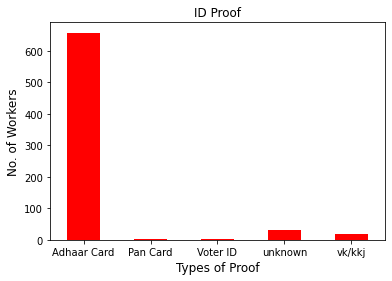

In [0]:
#visualizing the above dataframe
dfz.plot(kind='bar',color='red')
plt.title('ID Proof')
plt.xticks(rotation='0')
plt.ylabel('No. of Workers',fontsize=12)
plt.xlabel('Types of Proof',fontsize=12)
plt.show()

**Most of the workers have Aadhar Card as their ID Proof**

# **Analyzing Skills of Workers**

In [0]:
#creating dataframe for the skills of the workers
dfx=pd.read_excel('/content/skilldata.xlsx') #file has been made for finding unique skills
x=dfx['Current values'].tolist()
y=dfx['New Values'].tolist()
df.replace(x,y,inplace=True)
c=['#NAME?','Bakery','Bike Mechanic','Civil ','Civil Carpenter','Houswife','LAROURER','Marble','Operator Robot','Tailoring','Tiles ','Walk','Wandering','Welding','Carpentar']
d=['unknown','Bakery Worker','Mechanic','Civil','Civil','Housewife','Labourer','Marble Polish','Operator','Tailor','Tiles','Walking','Walking','Welding Work','Carpenter']
df.replace(c,d,inplace=True)
dfz4=df.groupby('Skill')['SerialNumber'].count()
dfz4.sort_values(axis=0,ascending=True,inplace=True)
dfz4.head()

Skill
Ac Work                   1
Medicine Factory Study    1
Online Bussiness          1
Online Delevery           1
Welfare                   1
Name: SerialNumber, dtype: int64

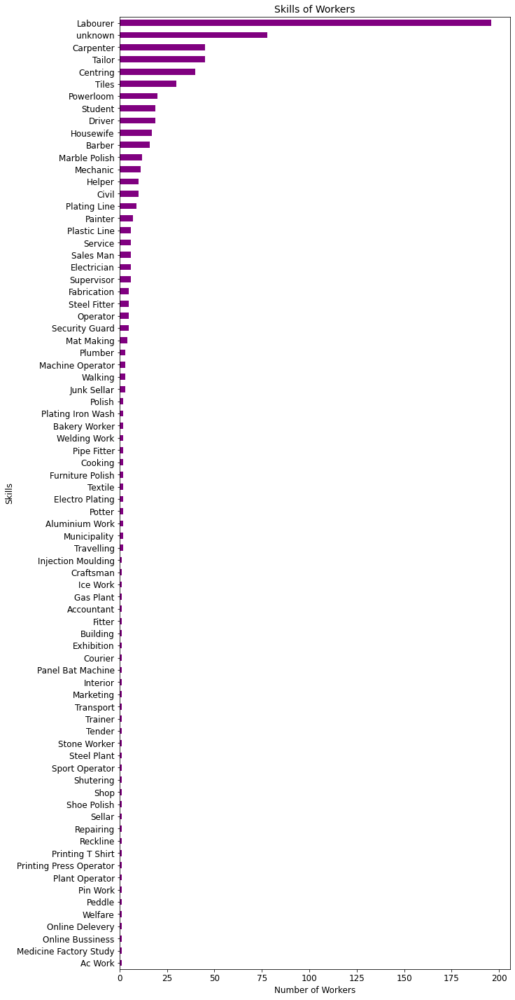

In [0]:
#visualizing the above dataframe
dfz4.plot(kind='barh',figsize=(10,25),color='purple',fontsize=12)
plt.title('Skills of Workers',fontsize=14)
plt.ylabel('Skills',fontsize=12)
plt.xlabel('Number of Workers',fontsize=12)
plt.show()

**Most of the workers are involved in Labour work**

# **Analyzing Age of Workers**

In [0]:
a=0;b=0;c=0;d=0;e=0;f=0;g=0;h=0;i=0;
for x in df['Age'].values:
  if x!='unknown':
    if x>0 and x<=10:
      a+=1
    elif x>10 and x<=20:
      b+=1
    elif x>20 and x<=30:
      c+=1
    elif x>30 and x<=40:
      d+=1
    elif x>40 and x<=50:
      e+=1
    elif x>50 and x<=60:
      f+=1
    elif x>60 and x<=70:
      g+=1
    elif x>70 and x<=80:
      h+=1
    else:
      i+=1
#creating dataframe for the age of the workers
data=[['0-10',a],['11-20',b],['21-30',c],['31-40',d],['41-50',e],['51-60',f],['61-70',g],['71-80',h],['81+',i]]
data1=pd.DataFrame(data,columns=['Age','Workers Count'])
data1=data1.set_index('Age')
data1.head()

,Workers Count
Age,
0-10,0
11-20,153
21-30,349
31-40,123
41-50,58


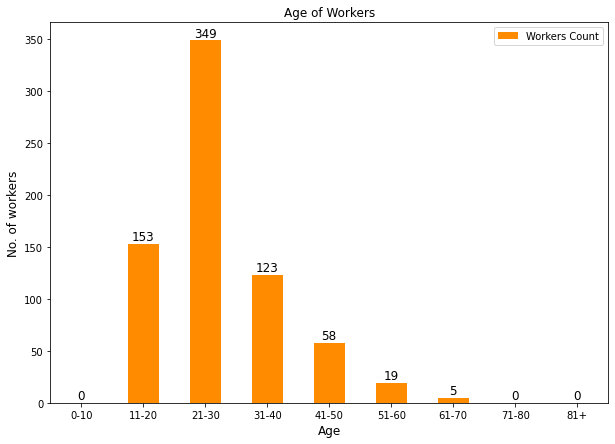

In [0]:
#visualizing the above dataframe
ax=data1.plot(kind='bar',figsize=(10,7),color='darkorange')
plt.xticks(rotation='0')
plt.ylabel('No. of workers',fontsize=12)
plt.xlabel('Age',fontsize=12)
plt.title('Age of Workers')
for p in ax.patches:
  ax.annotate(str(p.get_height()),(p.get_x()+p.get_width()/2,p.get_height()+7),ha='center',va='center',fontsize=12)
plt.show()

**Most of the workers are in the Age Group 21-30.**

# **Conclusion**

**This project shows that most of the workers in India are Male and are in the Age-group of 21-30. They are inexperienced and hence they do unskilled work or Labour work. Many of them come from Maharashtra and most of them possess Aadhar Card as their ID proof.**